In [2]:
%reload_ext autoreload
%autoreload 2

import osm_analysis 
import vyskopis
from coords_to_waypoints import coords_to_waypoints
from os import path
from background_map import get_background_image

from geodesy import utm

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import mpld3
from mpld3 import plugins

from math import atan2, degrees

mpld3.enable_notebook()
%matplotlib inline

SAFE_SLOPE = 5 #degs
WAYPOINTS_DENSITY = 30

In [3]:

# Generate waypoints
coords_file = "coords_haj.csv"
waypoints_file = "waypoints.csv"
coords_to_waypoints(WAYPOINTS_DENSITY, coords_file, waypoints_file)

Generated 42 waypoints from 2 coordinate pairs.


In [4]:
# Init osm path analysis.
path_analysis = osm_analysis.PathAnalysis(waypoints_file, WAYPOINTS_DENSITY)

In [5]:
# Keep queries separate, so that we don't have to rerun them
way_query = path_analysis.get_way_query()
osm_ways_data = path_analysis.api.query(way_query)

In [6]:
rel_query = path_analysis.get_rel_query()
osm_rels_data = path_analysis.api.query(rel_query)

In [7]:
node_query = path_analysis.get_node_query()
osm_nodes_data = path_analysis.api.query(node_query)

print("queries complete")

queries complete


In [16]:
path_analysis = osm_analysis.PathAnalysis(waypoints_file, WAYPOINTS_DENSITY)
# Run the osm analysis. Output is an array of waypoints with information.
path_analysis.way_query = way_query
path_analysis.osm_ways_data = osm_ways_data

path_analysis.rel_query = rel_query
path_analysis.osm_rels_data = osm_rels_data

path_analysis.node_query = node_query
path_analysis.osm_nodes_data = osm_nodes_data

path_analysis.run()

multi pol old 0.0003
multi pol old 0.0005
solved in 0.017911911010742188
range 10, increase 0, density 1, points 333
multi pol old 0.0003
multi pol old 0.0004
solved in 0.01830315589904785
range 10, increase 0, density 1, points 330
multi pol old 0.0003
multi pol old 0.0005
solved in 0.019257307052612305
range 10, increase 0, density 1, points 330
multi pol old 0.0003
multi pol old 0.0004
solved in 0.021744489669799805
range 10, increase 0, density 1, points 330
multi pol old 0.0003
multi pol old 0.0004
solved in 0.016529321670532227
range 10, increase 0, density 1, points 224
multi pol old 0.0004
multi pol old 0.0006
range 30, increase 10, density 1, points 51
multi pol old 0.0006
multi pol old 0.0007
solved in 0.054410457611083984
range 30, increase 10, density 1, points 845
multi pol old 0.0003
multi pol old 0.0006
solved in 0.015641212463378906
range 10, increase 0, density 1, points 130
multi pol old 0.0004
multi pol old 0.0006
range 30, increase 10, density 1, points 24
multi pol

In [17]:
# For some reason the following assignment doesn't work in the run() function,
# so we do it manually here.
""" for i,point in enumerate(path_analysis.points):
    path_analysis.points_information[i].x = point.x
    path_analysis.points_information[i].y = point.y """

' for i,point in enumerate(path_analysis.points):\n    path_analysis.points_information[i].x = point.x\n    path_analysis.points_information[i].y = point.y '

In [18]:
# Finally.
waypoints_information = np.array(path_analysis.points_information)
#obstacles =             np.array(list(path_analysis.obstacles))
roads =                 np.array(list(path_analysis.roads))
road_areas =            np.array(list(path_analysis.road_areas))
footways =              np.array(list(path_analysis.footways))
footway_areas =         np.array(list(path_analysis.footway_areas))
terrain_areas =         np.array(list(path_analysis.terrain_areas))
#barriers =              np.array(list(path_analysis.barriers))
barrier_areas =         np.array(list(path_analysis.barrier_areas))
min_x =                 path_analysis.min_x
min_y =                 path_analysis.min_y
max_x =                 path_analysis.max_x   
max_y =                 path_analysis.max_y
min_lat =               path_analysis.min_lat
min_long =              path_analysis.min_long
max_lat =               path_analysis.max_lat
max_long =              path_analysis.max_long

path =                  path_analysis.path

In [19]:
""" # Prepare for vyskopis analysis.
xyz_file = "vyskopis_dir/553988_CVUT/4g/KRAV69_4g.xyz"
if not path.exists(xyz_file[:-3]+"csv"):
    transformer = vyskopis.sjtsk2utm(xyz_file)
    transformer.run()
    transformer.save_to_file() """

' # Prepare for vyskopis analysis.\nxyz_file = "vyskopis_dir/553988_CVUT/4g/KRAV69_4g.xyz"\nif not path.exists(xyz_file[:-3]+"csv"):\n    transformer = vyskopis.sjtsk2utm(xyz_file)\n    transformer.run()\n    transformer.save_to_file() '

In [20]:
""" # Run vyskopis analysis. Output is height for each waypoints -- add that to the osm analysis output.
vyskopis_data = vyskopis.DataPoints("waypoints.csv",xyz_file[:-3]+"csv",4)
waypoints_height = vyskopis_data.run()

for i,height in enumerate(waypoints_height):
    waypoints_information[i].height = height

    if i < len(waypoints_height)-1:
        point = waypoints_information[i]
        next_point = waypoints_information[i+1]
        next_point_height = waypoints_height[i+1]
        slope = degrees(atan2(height-next_point_height, np.sqrt((point.x - next_point.x)**2+(point.y - next_point.y)**2)))
        waypoints_information[i].slope = slope
    else:
        waypoints_information[i].slope = waypoints_information[i-1].slope
    
plt.hist([point.slope for point in waypoints_information])
plt.show() """

' # Run vyskopis analysis. Output is height for each waypoints -- add that to the osm analysis output.\nvyskopis_data = vyskopis.DataPoints("waypoints.csv",xyz_file[:-3]+"csv",4)\nwaypoints_height = vyskopis_data.run()\n\nfor i,height in enumerate(waypoints_height):\n    waypoints_information[i].height = height\n\n    if i < len(waypoints_height)-1:\n        point = waypoints_information[i]\n        next_point = waypoints_information[i+1]\n        next_point_height = waypoints_height[i+1]\n        slope = degrees(atan2(height-next_point_height, np.sqrt((point.x - next_point.x)**2+(point.y - next_point.y)**2)))\n        waypoints_information[i].slope = slope\n    else:\n        waypoints_information[i].slope = waypoints_information[i-1].slope\n    \nplt.hist([point.slope for point in waypoints_information])\nplt.show() '

In [21]:
def get_color(point):
    if point.inside_barrier:
        return 'red'
    elif point.roads:
        return '#ffc800'
    else:
        return 'green'

def get_edgecolor(point):
    if point.is_crossing_road:
        return '#000000'
    else:
        #return "#ababab"
        return get_color(point)

def get_marker(point):
    if point.slope > SAFE_SLOPE:
        return 'v'
    if point.slope < -SAFE_SLOPE:
        return '^'
    else:
        return 'o'

def get_label(point):
    css = """
        table
        {
        border-collapse: collapse;
        }
        th
        {
        color: #ffffff;
        background-color: #000000;
        }
        td
        {
        color: #000000;
        background-color: #cccccc;
        }
        table, th, td
        {
        font-family:Arial, Helvetica, sans-serif;
        border: 1px solid black;
        text-align: right;
        }
        """

    tags = point.repr_dict() 
    tags['slope'] = [None,round(point.slope,2)] 

    df = pd.DataFrame.from_dict(tags, orient='index')
    df.fillna('-', inplace=True)
    label = df
    #label = df.T
    label = str(label.to_html(header = False))
    return [label],css

def plot_obstacles(obstacles, ax):
    for obstacle in obstacles:
        x = obstacle.point.x
        y = obstacle.point.y
        ax.scatter(x, y, color='#BF0009', s=20, marker='X', zorder = 200)

def plot_path(path, ax):
    ax.scatter(path[::2,0], path[::2,1], color='#000000', s=3, marker='o', zorder = 18000)
    ax.scatter(path[::2,0], path[::2,1], color='#50C2F6', s=2, marker='o', zorder = 20000)

def plot_barriers(barriers, ax):
    for barrier in barriers:
        x,y = barrier.line.xy
        ax.plot(x, y, c='#BF0009', linewidth=5, zorder = 3)

def plot_barrier_areas(barrier_areas, ax):
    for area in barrier_areas:
        x,y = area.line.exterior.xy
        ax.plot(x, y, c='#BF0009', linewidth=5, zorder = 7)
        
        if area.in_out != "inner":
            ax.fill(x,y,c='#BF0009', alpha=0.4, zorder = 5)

def plot_road_areas(road_areas, ax):
    for area in road_areas:
        x,y = area.line.exterior.xy
        ax.plot(x, y, c='#fdbf65', linewidth=5, zorder = 3)
        ax.fill(x,y,c='#fdbf65', alpha=0.4, zorder = 2)
        
def plot_roads(roads, ax):
    for road in roads:
        if road.is_area:
            x,y = road.line.exterior.xy
        else:
            x,y = road.line.xy

        ax.plot(x, y, c='#707070', linewidth=8, zorder = 12)
        ax.plot(x, y, c='#000000', linewidth=10, zorder = 10)
        ax.plot(x, y, c='#ffffff', linewidth=2, linestyle = '--', zorder = 14)

def plot_footways(footways, ax):
    for footway in footways:
        if footway.is_area:
            x,y = footway.line.exterior.xy
        else:
            x,y = footway.line.xy

        ax.plot(x, y, c='#968A71', linewidth=4, zorder = 6)
        ax.plot(x, y, c='#000000', linewidth=6, zorder = 4)
        #ax.plot(x, y, c='#ffffff', linewidth=1, linestyle = '--', zorder = 4)


def get_margin(min_long,max_long,min_lat,max_lat):
    y_margin = (max_lat-min_lat) * 0.1
    x_margin = (max_long-min_long) * 0.1

    if y_margin < x_margin:
        y_margin = x_margin
    else:
        x_margin = y_margin
    
    return x_margin, y_margin

def plot_background_map(ax, image):

    min_utm = utm.fromLatLong(min_lat - y_margin, min_long - x_margin)
    max_utm = utm.fromLatLong(max_lat + y_margin, max_long + x_margin)
    ax.imshow(image, extent = [min_utm.easting,\
                                max_utm.easting,\
                                min_utm.northing,\
                                max_utm.northing], alpha = 0.8, zorder = 0)

    ax.set_ylim([min_utm.northing, max_utm.northing])
    ax.set_xlim([min_utm.easting, max_utm.easting])

In [22]:
x_margin, y_margin = get_margin(min_long,max_long,min_lat,max_lat)
background_map = get_background_image(min_long, max_long, min_lat, max_lat, x_margin, y_margin)

https://maps.geoapify.com/v1/staticmap?style=osm-carto&width=2361&height=3717&area=rect:14.427500563020171,50.13472166401327,14.43831510983931,50.12377732833707&apiKey=8f3be3c0c8484eceb15b0f50218c8c02


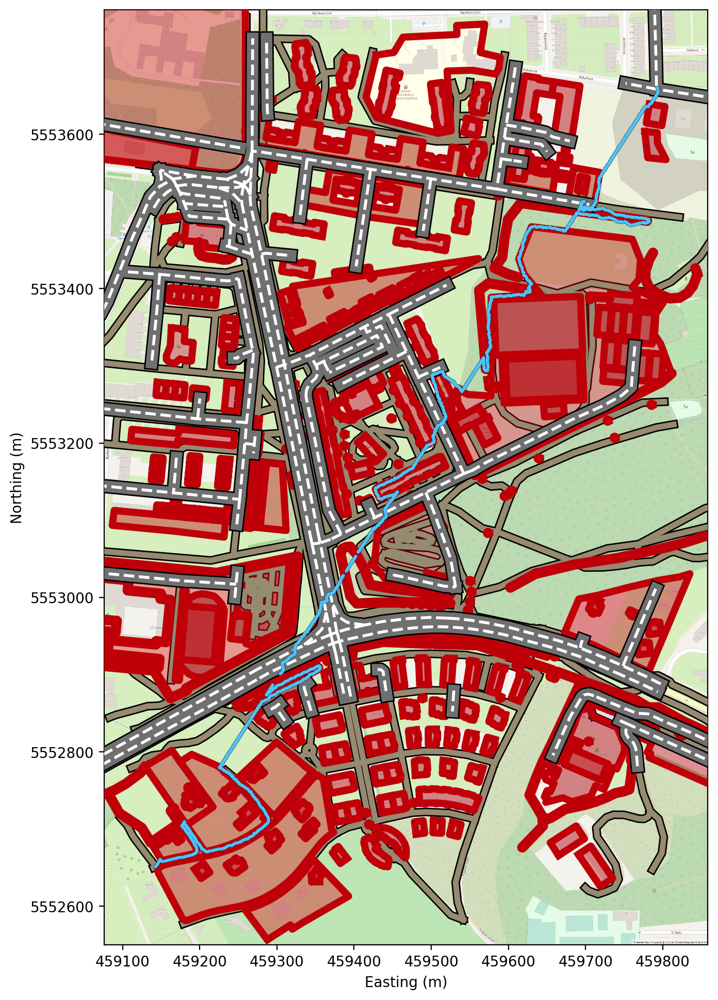

In [23]:
# Visualize
fig, ax = plt.subplots(figsize=(12,12), dpi=200)
N = 100

plot_background_map(ax, background_map)
#plot_obstacles(obstacles, ax)
#plot_barriers(barriers, ax)
plot_barrier_areas(barrier_areas,ax)
plot_roads(roads,ax)
plot_road_areas(road_areas, ax)
plot_footways(footways,ax)
plot_path(path,ax)


""" for i,point in enumerate(waypoints_information):
    color = get_color(point)
    edgecolor = get_edgecolor(point)
    alpha = 1
    size = 40
    marker = get_marker(point)
    label, css = get_label(point)

    scatter = ax.scatter(point.x, point.y, color=color, edgecolor=edgecolor, linewidth = 3, alpha=alpha, s=size, marker=marker, zorder = 100)
    
    if i+1 < len(waypoints_information):
        next = waypoints_information[i+1]
        ax.plot([point.x,next.x],[point.y,next.y],c='black',linewidth =3, linestyle = 'dashed',zorder=98)

    tooltip = plugins.PointHTMLTooltip(scatter, voffset=10, hoffset=10, css=css, labels = label)
    plugins.connect(fig, tooltip) """
        
ax.set_aspect('equal', adjustable='box')
ax.set_xlabel('Easting (m)')
ax.set_ylabel('Northing (m)')
plt.show()
#mpld3.display()
